In [2]:
# must run in an environment where polarityJaM is installed
from polarityjam import Extractor, Plotter, CellposeSegmenter, PropertiesCollection
from polarityjam import RuntimeParameter, PlotParameter, SegmentationParameter, ImageParameter
from polarityjam.utils.io import read_image

from pathlib import Path

# Setup

In [3]:
input_file = Path("/home/jpa/tmp/polarityjam/data/golgi_nuclei/set_1/060721_EGM2_18dyn_01.tif")
output_path = Path("/home/jpa/tmp/polarityjam_out/")
output_file_prefix = "060721_EGM2_18dyn_01"

In [4]:
# read input
img = read_image(input_file)

# describe your image with ImageParameter
params_image = ImageParameter()

# set the channels
params_image.channel_organelle = 0  # golgi channel
params_image.channel_nucleus = 2
params_image.channel_junction = 3
params_image.channel_expression_marker = 3
params_image.pixel_to_micron_ratio = 2.4089

# look at the parameters
print(params_image)

ImageParameter:  
channel_junction              3                                       
channel_nucleus               2                                       
channel_organelle             0                                       
channel_expression_marker     3                                       
pixel_to_micron_ratio         2.4089                                  



In [5]:
# define other parameters, use default values
params_runtime = RuntimeParameter()  # use default values
params_seg = SegmentationParameter()  # use default values
params_plot = PlotParameter()  # use default values

print(params_runtime)

RuntimeParameter:  
membrane_thickness            5                                       
feature_of_interest           cell_area                               
min_cell_size                 50                                      
min_nucleus_size              10                                      
min_organelle_size            10                                      
dp_epsilon                    5                                       



# DeepLearning Segmentation

In [6]:
# Define a Cellpose Segmenter with the parameters
cellpose_segmentation = CellposeSegmenter(params_seg)

# prepare the segmentation
img_channels, img_channels_params = cellpose_segmentation.prepare(img, params_image)

cellprob_threshold and dist_threshold are being deprecated in a future release, use mask_threshold instead


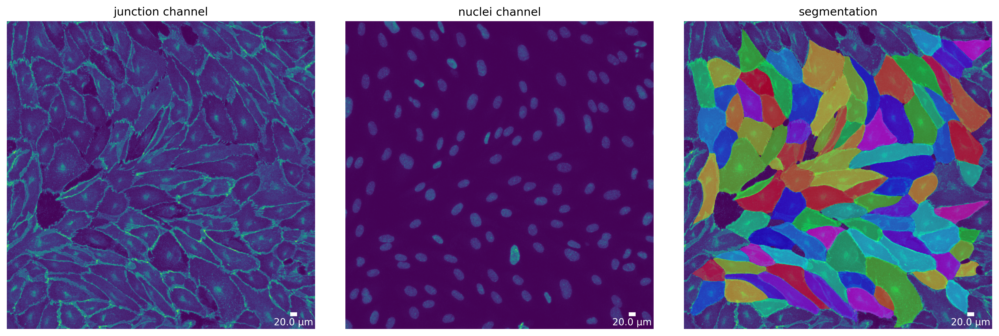

In [7]:
# segment your image
mask = cellpose_segmentation.segment(img_channels, input_file)

# plot segmentation mask to check the quality
plotter = Plotter(params_plot)
plotter.plot_mask(mask, img_channels, img_channels_params, output_path, output_file_prefix)


# Feature extraction

In [8]:
# setup a colletion
collection = PropertiesCollection()

# feature extraction
extractor = Extractor(params_runtime)
extractor.extract(img, params_image, mask, output_file_prefix, output_path, collection)

# look at your dataset
collection.dataset.head()


,filename,img_hash,label,cell_X,cell_Y,cell_shape_orientation_rad,cell_shape_orientation_deg,cell_major_axis_length,cell_minor_axis_length,cell_eccentricity,...,morans_p_norm,neighbors_cell,neighbors_mean_dif_1st,neighbors_median_dif_1st,neighbors_stddev_dif_1st,neighbors_range_dif_1st,neighbors_mean_dif_2nd,neighbors_median_dif_2nd,neighbors_stddev_dif_2nd,neighbors_range_dif_2nd
1,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,17.0,68.477653,804.993960,2.525143,144.680027,114.164720,69.789749,0.791393,...,0.096469,3.0,-499.333333,-265.0,855.157036,2055.0,2421.250000,2092.0,3161.303637,7365.0
2,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,18.0,112.365152,216.717906,1.772854,101.577056,131.758840,79.042332,0.800074,...,0.096469,4.0,830.500000,1023.5,997.362647,2629.0,1808.666667,1028.0,3788.546540,11784.0
3,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,19.0,88.122335,962.746247,0.031579,1.809338,118.404769,67.778780,0.819952,...,0.096469,1.0,-1244.000000,-1244.0,0.000000,0.0,267.500000,267.5,132.500000,265.0
4,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,20.0,155.107352,459.765362,1.453797,83.296443,157.325719,138.722923,0.471705,...,0.096469,4.0,-6958.750000,-6791.0,2145.264713,5777.0,-10233.000000,-10853.0,1680.279739,5444.0
5,060721_EGM2_18dyn_01,b263ebb1c6960869667a476fa55cb7fb84faf357,21.0,107.061672,906.465671,2.409574,138.058415,144.501883,37.908917,0.964975,...,0.096469,3.0,1422.333333,1379.0,166.149197,400.0,5066.000000,5066.0,3011.000000,6022.0


In [9]:
# save your dataset to disk
collection.dataset.to_csv(output_path.joinpath('features.csv'))


# Visualization

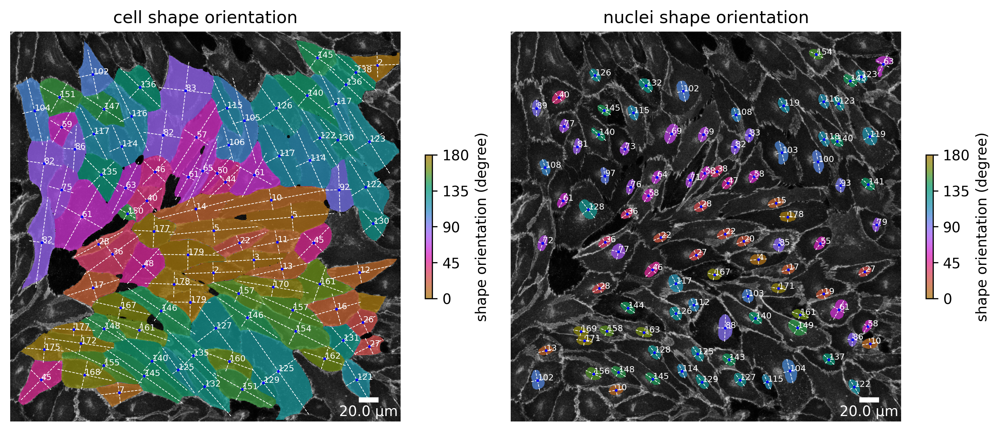

In [10]:
# plot the cell orientation of a specific image in your collection
plotter.plot_orientation(collection, "060721_EGM2_18dyn_01")

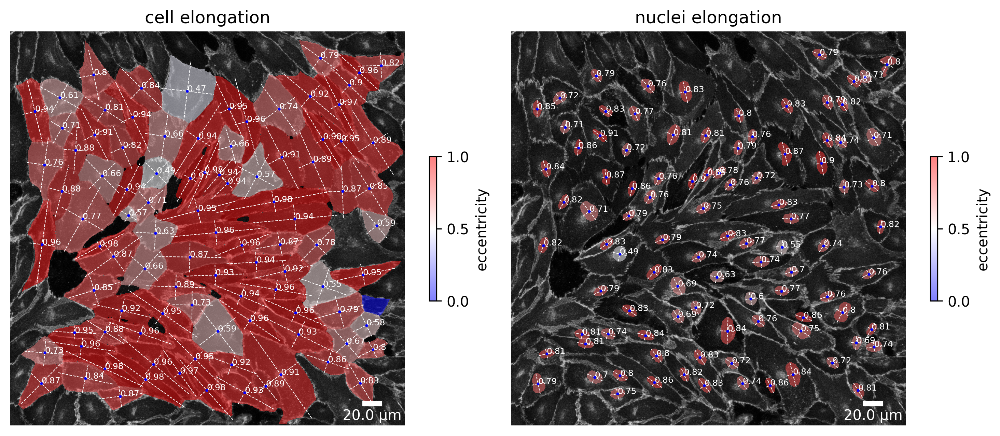

In [11]:
# plot the cell eccentricity of a specific image in your collection
plotter.plot_eccentricity(collection, "060721_EGM2_18dyn_01")

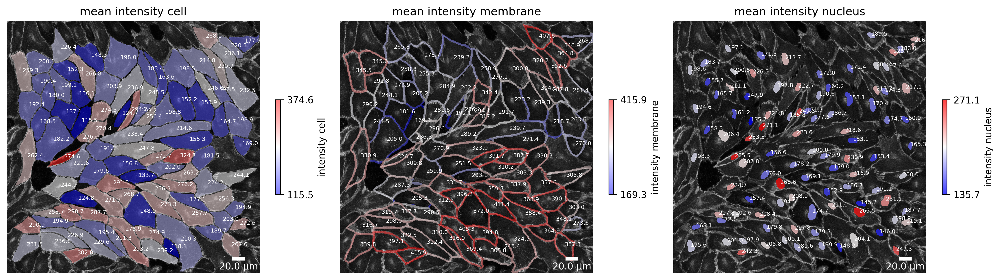

In [12]:
# plot the marker expression of a specific image in your collection
plotter.plot_marker_expression(collection, "060721_EGM2_18dyn_01")